# Text To Speech & Speech To Text

1. [Text To Speech](#text_to_speech)
2. [Speech To Text](#speec_to_text)
3. [OpenAI Whisper](#openai_whisper)
4. [Video Transcription](#video_transcription)



In [1]:
# Ignore All Warnings
import warnings
warnings.filterwarnings("ignore")

# Text To Speech <a name="text_to_speech"></a>

### SpeechBrain: A PyTorch Speech Toolkit
SpeechBrain: [`🌐 Official Website`](https://speechbrain.github.io/) | [`🤗 Hugging Face`](https://huggingface.co/speechbrain)

🤗 Hugging Face Models: [`Text To Speech`](https://huggingface.co/models?pipeline_tag=text-to-speech&sort=trending)

Used Model: [`Text-to-Speech (TTS) with Tacotron2 trained on LJSpeech`](https://huggingface.co/speechbrain/tts-tacotron2-ljspeech)

Used Vocoder: [`Vocoder with HiFIGAN trained on LJSpeech`](https://huggingface.co/speechbrain/tts-hifigan-ljspeech)

In [2]:
! pip install -q speechbrain

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 553.8/553.8 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 10.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 10.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 109.6/109.6 kB 11.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 485.6/485.6 kB 13.7 MB/s eta 0:00:00


In [3]:
import torchaudio
from speechbrain.pretrained import Tacotron2
from speechbrain.pretrained import HIFIGAN

In [4]:
tacotron2 = Tacotron2.from_hparams(source = "speechbrain/tts-tacotron2-ljspeech", savedir = "tmpdir_tts")
hifi_gan = HIFIGAN.from_hparams(source = "speechbrain/tts-hifigan-ljspeech", savedir = "tmpdir_vocoder")

mel_output, mel_length, alignment = tacotron2.encode_text("You can figure out what the villain fears by his choice of weapons")
waveforms = hifi_gan.decode_batch(mel_output)

torchaudio.save("mc.wav", waveforms.squeeze(1), 16_000)

In [5]:
from IPython.display import Audio

Audio("mc.wav")

# Speech To Text <a name="speec_to_text"></a>

### Transformers
Transformers: [`🤗 Hugging Face`](https://huggingface.co/docs/transformers/index)

🤗 Hugging Face Models: [`Automatic Speech Recognition`](https://huggingface.co/models?pipeline_tag=automatic-speech-recognition&sort=trending)

Used Model: [`Wav2Vec2-Large-960h-Lv60 + Self-Training`](https://huggingface.co/facebook/wav2vec2-large-960h-lv60-self)

In [6]:
! pip install -q transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 42.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 64.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 53.0 MB/s eta 0:00:00


In [7]:
from transformers import Wav2Vec2ForCTC, Wav2Vec2Tokenizer

tokenizer = Wav2Vec2Tokenizer.from_pretrained("facebook/wav2vec2-large-960h-lv60-self")
model = Wav2Vec2ForCTC.from_pretrained("facebook/wav2vec2-large-960h-lv60-self")

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'Wav2Vec2CTCTokenizer'. 
The class this function is called from is 'Wav2Vec2Tokenizer'.


Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-large-960h-lv60-self and are newly initialized: ['wav2vec2.masked_spec_embed']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Torch: [`⚙️ PyTorch`](https://pytorch.org/get-started/locally/)

🔉 Torchaudio: [`📘 Documentation`](https://pytorch.org/audio/stable/index.html)

In [8]:
import torchaudio, torch

waveform, sample_rate = torchaudio.load("mc.wav")
waveform, sample_rate

(tensor([[ 0.0013,  0.0010,  0.0011,  ..., -0.0007, -0.0004, -0.0003]]), 16000)

In [9]:
input_values = tokenizer(waveform, return_tensors="pt").input_values
input_values

tensor([[[ 0.0263,  0.0190,  0.0218,  ..., -0.0170, -0.0100, -0.0081]]])

In [10]:
with torch.no_grad():
  logits = model(input_values.squeeze(dim=0))
  predicted_ids = torch.argmax(logits.logits, dim=-1)
  transcription = tokenizer.batch_decode(predicted_ids)[0]

transcription

'YOU CAN FIGURE OUT WHAT THE VILLAIN FEARS BY HIS CHOICE OF WEAPON'

# OpenAI Whisper <a name="openai_whisper"></a>
*Advance Implementation of Speech-to-Text Using OpenAI*

Used Model: [`OpenAI Whisper Tiny`](https://huggingface.co/openai/whisper-tiny)

Alternative Large Version of the used model: [`OpenAI Whisper Large V2`](https://huggingface.co/openai/whisper-large-v2)

In [11]:
from transformers import WhisperProcessor, WhisperForConditionalGeneration
import torchaudio, torch


processor = WhisperProcessor.from_pretrained("openai/whisper-tiny")
model = WhisperForConditionalGeneration.from_pretrained("openai/whisper-tiny")
model.config.forced_decoder_ids = None

In [12]:
waveform, sample_rate = torchaudio.load("mc.wav")

input_features = processor(waveform.squeeze(dim=0), return_tensors="pt").input_features
predicted_ids = model.generate(input_features)

transcription = processor.batch_decode(predicted_ids, skip_special_tokens=True)
transcription[0]

It is strongly recommended to pass the `sampling_rate` argument to this function. Failing to do so can result in silent errors that might be hard to debug.


' You can figure out what the villain fears by his choice of weapon.'

# Video Transcription <a name="video_transcription"></a>

PyTube: [`🌐 Official Website`](https://pytube.io/en/latest/)

In [13]:
! pip install -q pytube

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.6/57.6 kB 1.0 MB/s eta 0:00:00


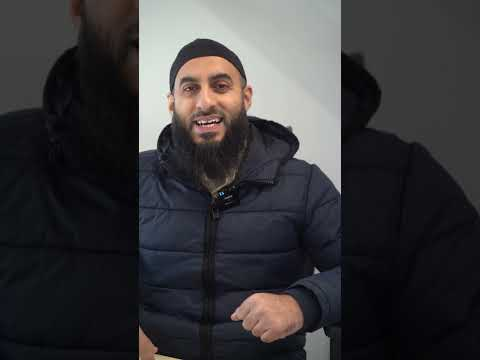

In [14]:
from IPython.display import YouTubeVideo

video_id = "uiMxaIG9KGQ"
YouTubeVideo(video_id)

In [15]:
# Download The YouTube Video
import pytube


url = "https://www.youtube.com/watch?v=uiMxaIG9KGQ"
video = pytube.YouTube(url)

stream = video.streams.filter(only_audio=True).first()
stream.download(filename="video.mp4")

'/content/video.mp4'

In [16]:
# Extract audio from the downloaded video
import subprocess

subprocess.call(["ffmpeg", "-i", "video.mp4", "audio.wav"])

0

In [17]:
waveform, sample_rate = torchaudio.load("audio.wav")
waveform, sample_rate

(tensor([[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]),
 44100)

In [18]:
resampler = torchaudio.transforms.Resample(sample_rate, 16000)
waveform = resampler(waveform)[0]

In [19]:
Audio("audio.wav")

In [20]:
input_features = processor(waveform.squeeze(dim=0), return_tensors="pt").input_features
predicted_ids = model.generate(input_features)

transcription = processor.batch_decode(predicted_ids, skip_special_tokens=True)
transcription[0]

It is strongly recommended to pass the `sampling_rate` argument to this function. Failing to do so can result in silent errors that might be hard to debug.


" Alhamdulillah, Assalamualaikum guys, I have some good news and bad news. The good news is that President Erdogan has promised to rebuild the houses of all of those who are devastated by the earthquake on the tech side. The bad news is the Syrians who are devastated by the earthquake on the other side. They don't have that same luxury of their houses being rebuilt by their government. In fact, they're even struggling to receive aid from the charities because a lot of the charities struggle to actually get into Syria. And some who can,"

*Automatically truncated after 448 tokens by default* ⤴️
